<a href="https://colab.research.google.com/github/rick77777/License-Plate-Detection/blob/main/Project_run_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!sudo apt install tesseract-ocr libtesseract-dev
!pip -q install pytesseract
!pip install easyocr

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libarchive-dev libleptonica-dev tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  libarchive-dev libleptonica-dev libtesseract-dev tesseract-ocr
  tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 6 newly installed, 0 to remove and 45 not upgraded.
Need to get 8,560 kB of archives.
After this operation, 31.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 libarchive-dev amd64 3.6.0-1ubuntu1.1 [582 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libleptonica-dev amd64 1.82.0-3build1 [1,562 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libtesseract-dev amd64 4.1.1-2.1build1 [1,600 kB]
Get:4 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:5 http://arc

In [3]:
from google.colab import drive
from google.colab import files
from google.colab.patches import cv2_imshow
drive.mount('/content/drive')

import cv2
import numpy as np
import matplotlib.pyplot as plt
import easyocr
import copy
import imutils

import pytesseract

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
def adjust_brightness_contrast(image, brightness=0, contrast=0):
    if brightness != 0:
        # Calculate brightness adjustment
        if brightness > 0:
            shadow = brightness
            highlight = 255
        else:
            shadow = 0
            highlight = 255 + brightness
        alpha_b = (highlight - shadow) / 255
        gamma_b = shadow

        # Apply brightness adjustment
        image = cv2.addWeighted(image, alpha_b, image, 0, gamma_b)

    if contrast != 0:
        # Calculate contrast adjustment
        f = 131 * (contrast + 127) / (127 * (131 - contrast))
        alpha_c = f
        gamma_c = 127 * (1 - f)

        # Apply contrast adjustment
        image = cv2.addWeighted(image, alpha_c, image, 0, gamma_c)

    return image

def get_text_from_license_plate(gray):
    # gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

    # Apply binary thresholding
    _, binary = cv2.threshold(gray, 150, 255, cv2.THRESH_BINARY_INV)

    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter and sort contours
    character_contours = []
    for contour in contours:
        x, y, w, h = cv2.boundingRect(contour)
        aspect_ratio = w / float(h)
        if 0.2 < aspect_ratio < 1.0 and h > 20:
            character_contours.append((x, y, w, h))

    # Sort contours left to right
    character_contours = sorted(character_contours, key=lambda c: c[0])

    # Initialize an empty string to store the license plate text
    license_plate_text_tes = ''
    license_plate_text = ''

    # Extract and OCR each character
    for (x, y, w, h) in character_contours:
        char_img = binary[y:y+h, x:x+w]
        # Resize the character for better OCR accuracy
        char_img = cv2.resize(char_img, (0, 0), fx=5, fy=5)
        char_img = cv2.copyMakeBorder(char_img, 10, 10, 10, 10, cv2.BORDER_CONSTANT, value=[0, 0, 0])

        reader = easyocr.Reader(['en']) #create an easyocr reader object with english as the language
        result = reader.readtext(char_img) #read text from the cropped image
        if len(result) > 0 and len(result[0]) > 1:
            license_plate_text += result[0][1]

        # Recognize the character using Tesseract
        char_text = pytesseract.image_to_string(char_img, config='--psm 10 -c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789')
        license_plate_text_tes += char_text.strip()

    return license_plate_text, license_plate_text_tes

Original Image


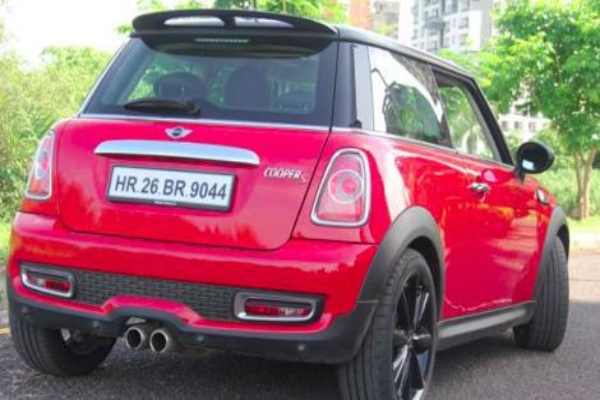

Brightened Image


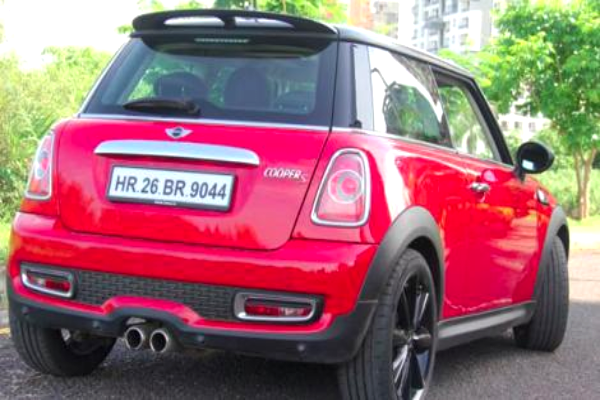

Grayscale Image


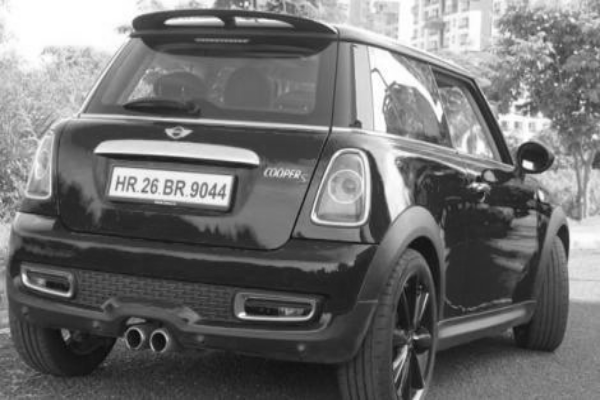

Blurred Image


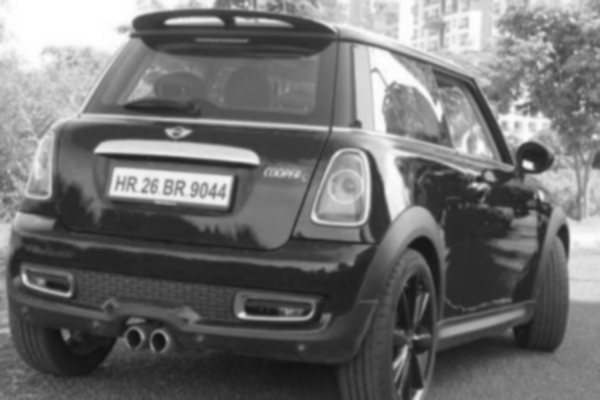

Adaptive threshold Image


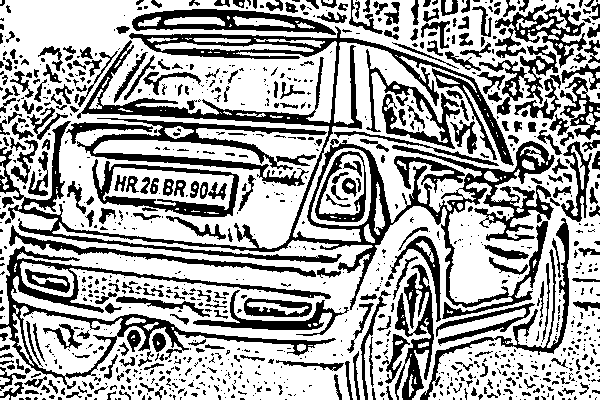

aspect:  7.357142857142857
area:  3567.5
approx:  [[[131  21]]

 [[255  10]]

 [[336  34]]

 [[136  31]]]
aspect:  3.046511627906977
area:  3491.5
approx:  [[[103 196]]

 [[226 209]]

 [[233 176]]

 [[114 167]]]
Final contour values - aspect: 3.046511627906977 area: 3491.5
Approximations:  [array([[[103, 196]],

       [[226, 209]],

       [[233, 176]],

       [[114, 167]]], dtype=int32)]


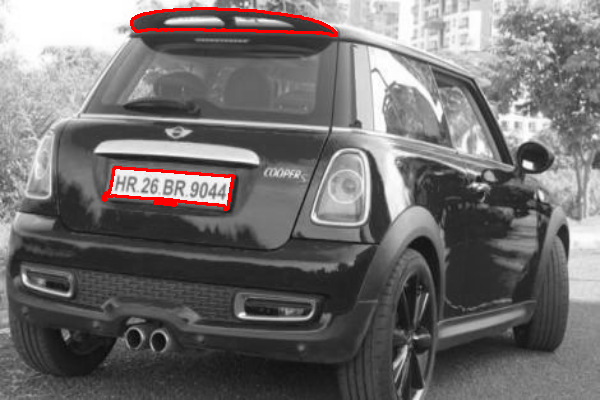

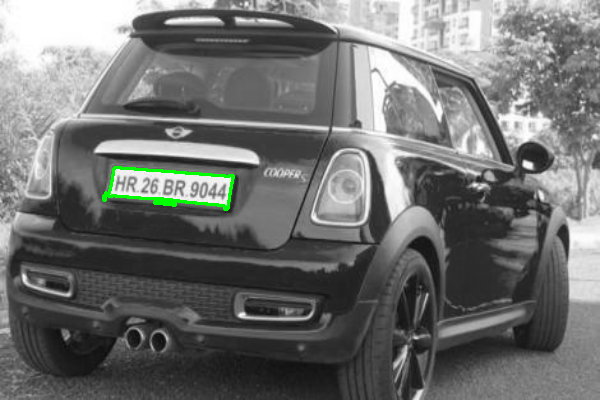

new_image after draw contours


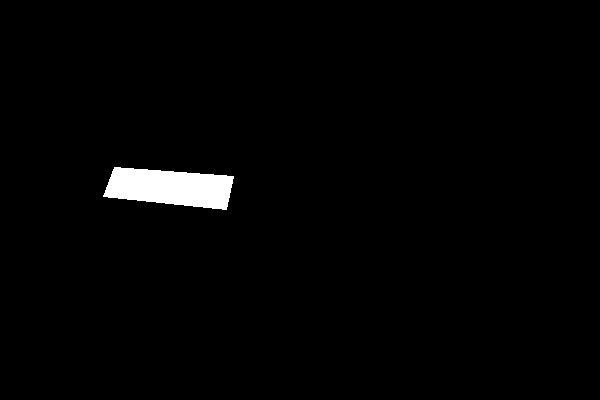

new_image after bitwise


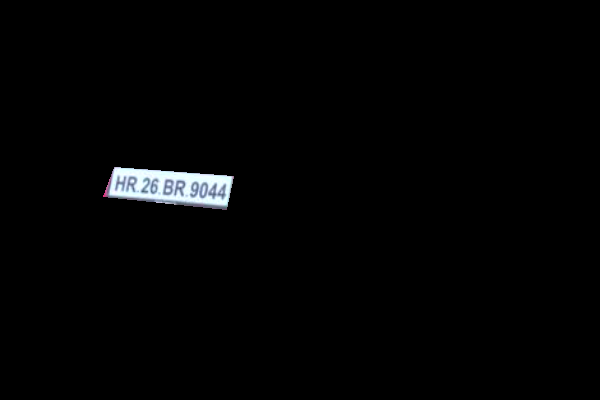

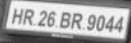

Detected Number Plate: HR 26 BR 90441
Detected Number Plate tes: 


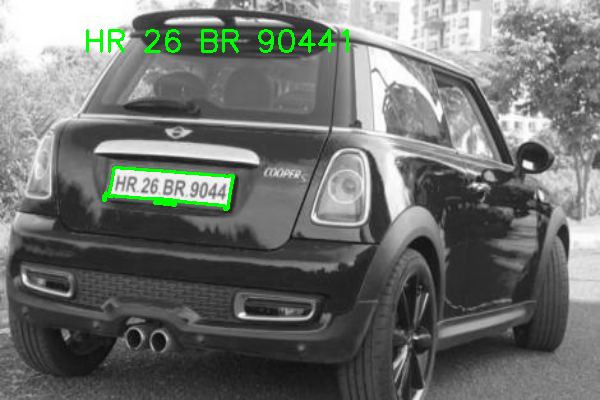

Original Image


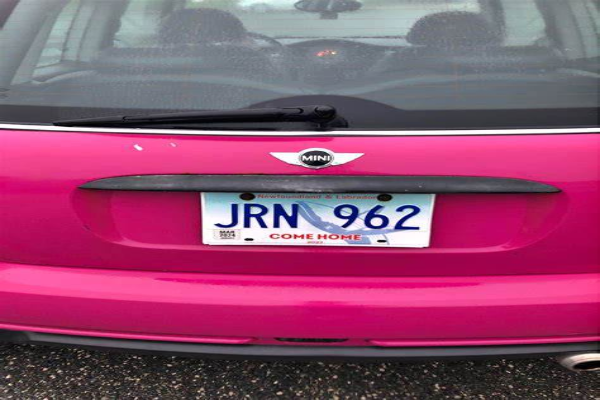

Brightened Image


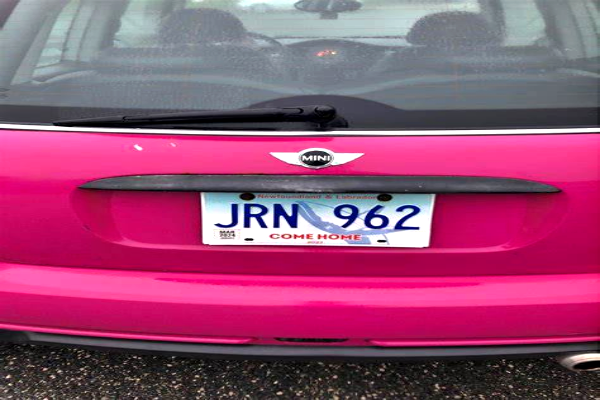

Grayscale Image


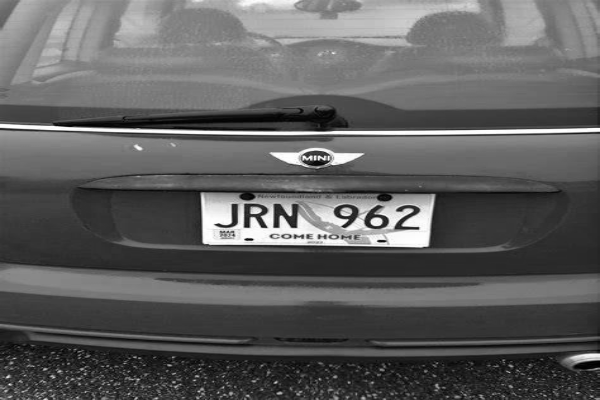

Blurred Image


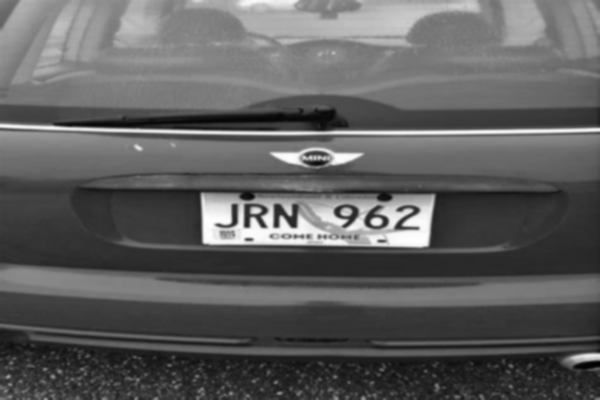

Adaptive threshold Image


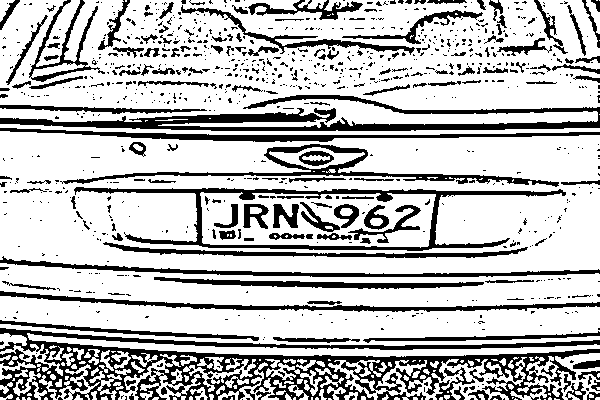

aspect:  13.636363636363637
area:  16964.5
approx:  [[[  0 263]]

 [[ 95 298]]

 [[599 301]]

 [[598 273]]]
aspect:  4.214285714285714
area:  11448.0
approx:  [[[202 242]]

 [[427 246]]

 [[435 194]]

 [[201 192]]]
Final contour values - aspect: 4.214285714285714 area: 11448.0
aspect:  4.363636363636363
area:  1049.0
approx:  [[[269 152]]

 [[309 168]]

 [[364 154]]

 [[320 147]]]
Final contour values - aspect: 4.363636363636363 area: 1049.0
Approximations:  [array([[[202, 242]],

       [[427, 246]],

       [[435, 194]],

       [[201, 192]]], dtype=int32), array([[[269, 152]],

       [[309, 168]],

       [[364, 154]],

       [[320, 147]]], dtype=int32)]


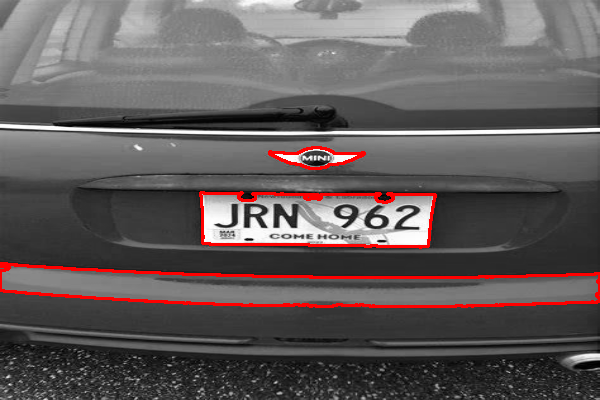

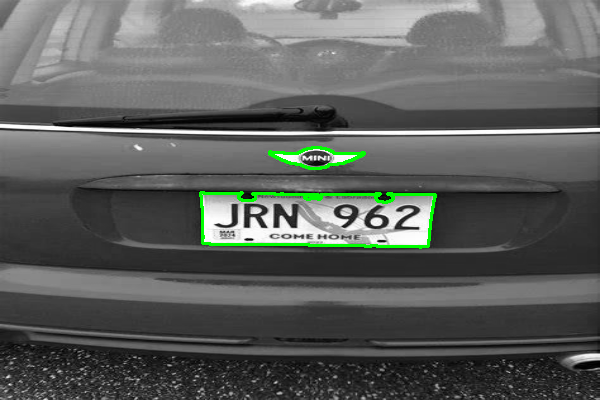

new_image after draw contours


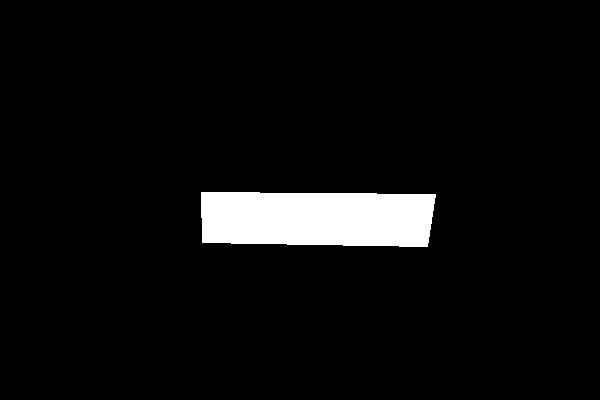

new_image after bitwise


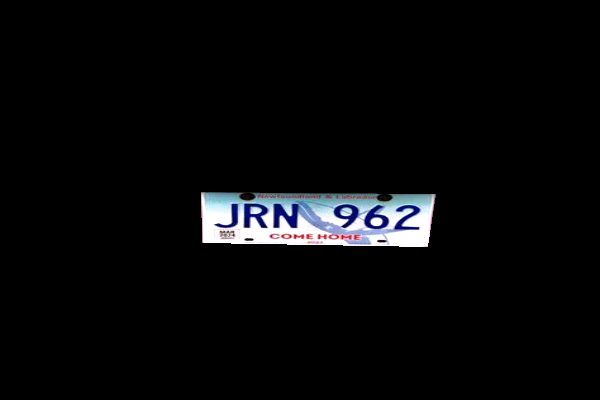

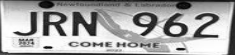

new_image after draw contours


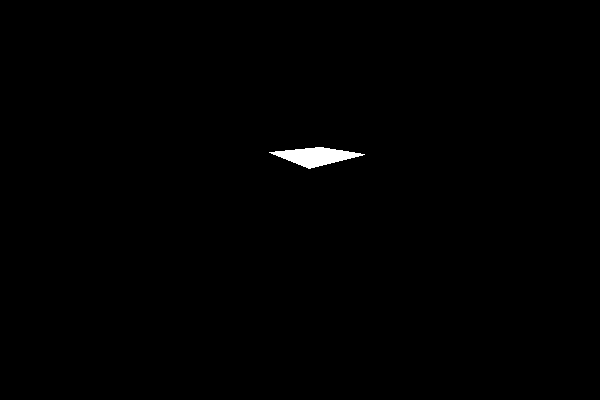

new_image after bitwise


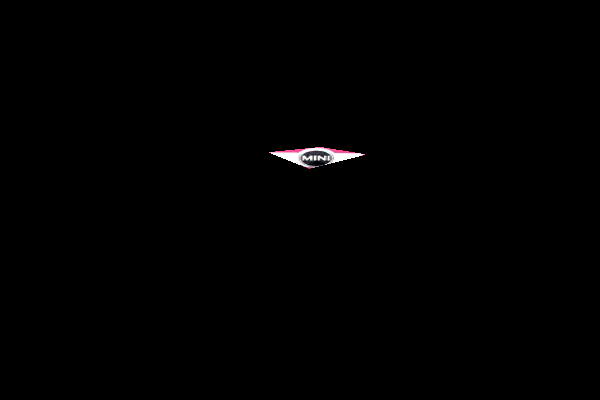

Detected Number Plate: JRN
Detected Number Plate tes: JRNV962

cone OME



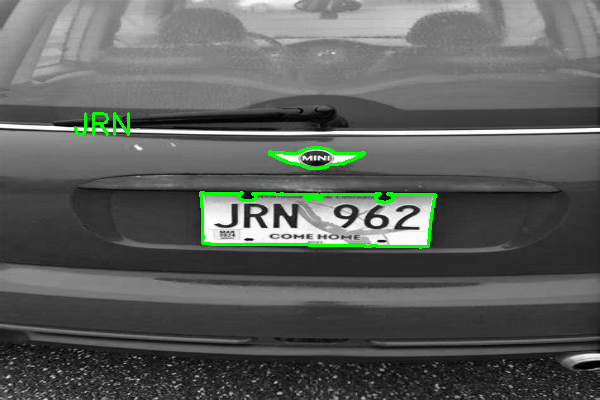

Original Image


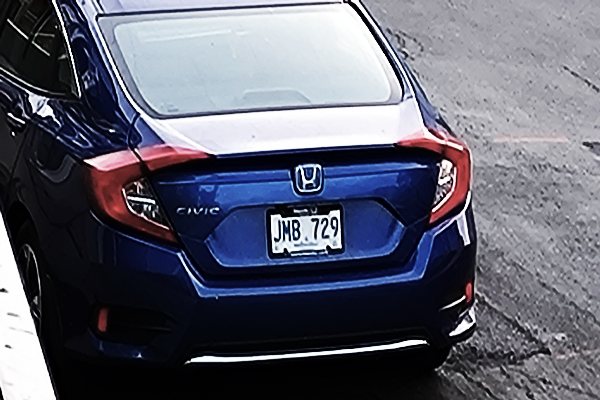

Brightened Image


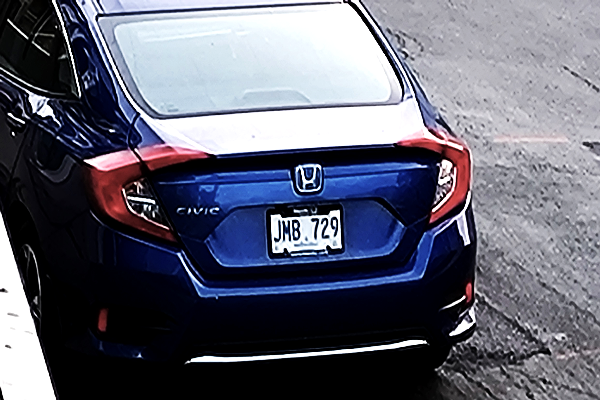

Grayscale Image


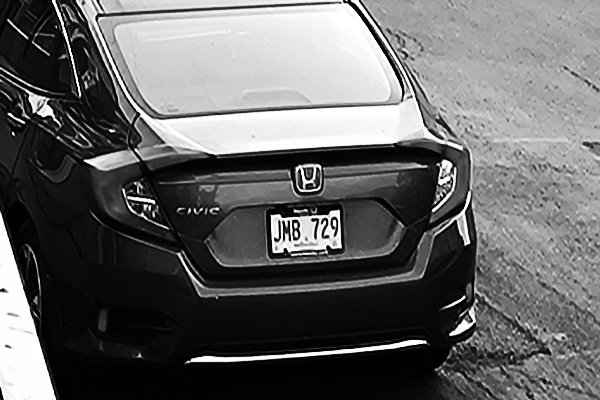

Blurred Image


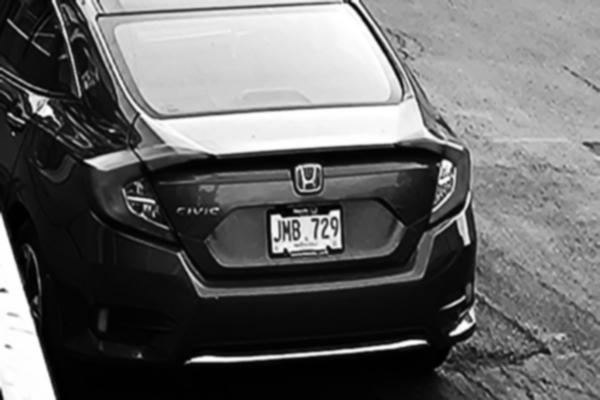

Adaptive threshold Image


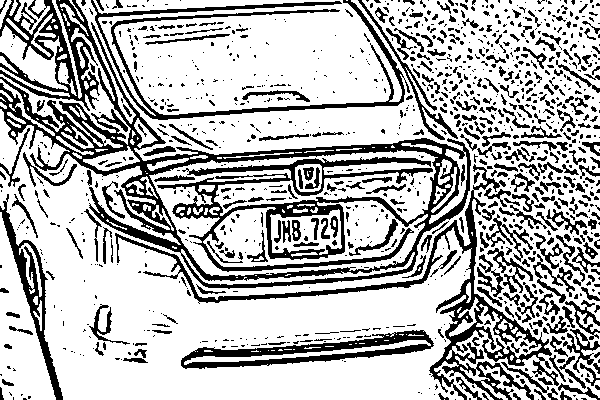

aspect:  6.219512195121951
area:  4763.5
approx:  [[[434 343]]

 [[180 365]]

 [[203 346]]

 [[412 329]]]
aspect:  1.565217391304348
area:  2341.0
approx:  [[[339 210]]

 [[271 214]]

 [[272 252]]

 [[340 248]]]
Final contour values - aspect: 1.565217391304348 area: 2341.0
Approximations:  [array([[[339, 210]],

       [[271, 214]],

       [[272, 252]],

       [[340, 248]]], dtype=int32)]


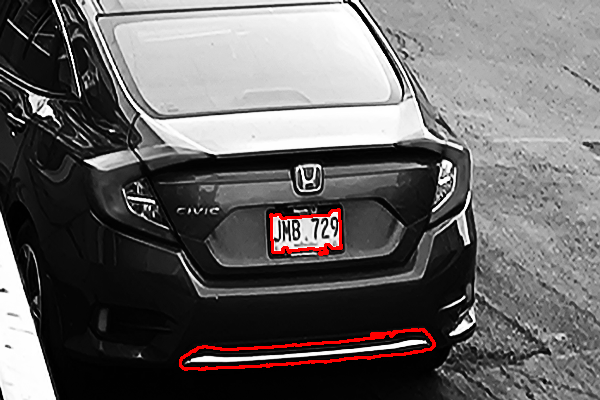

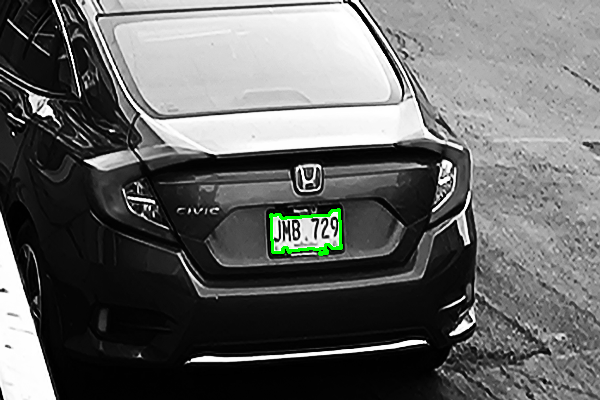

new_image after draw contours


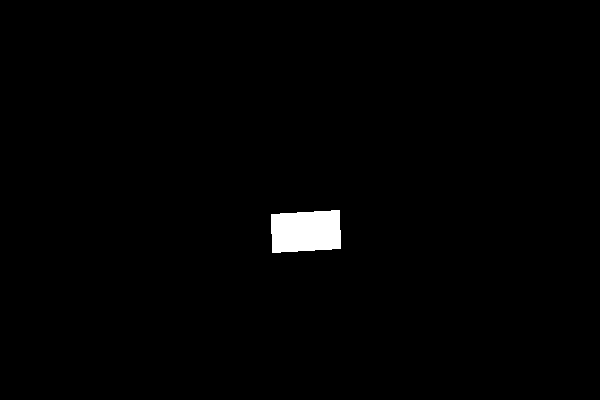

new_image after bitwise


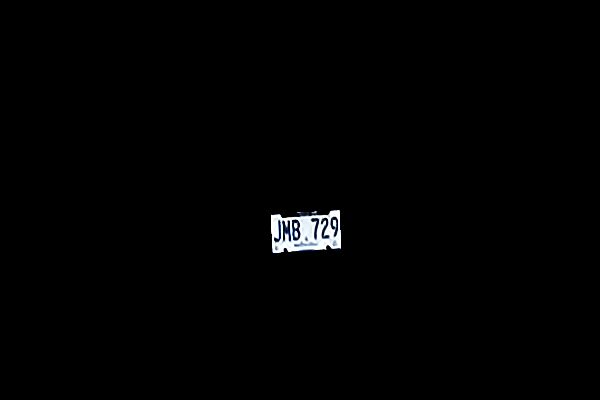

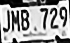

Detected Number Plate: JB 729
Detected Number Plate tes: ‘we 779



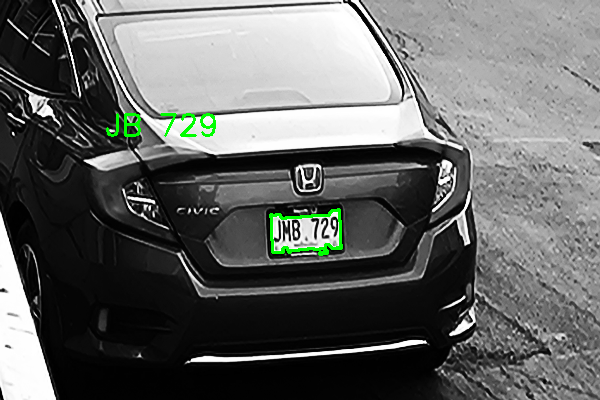

Original Image


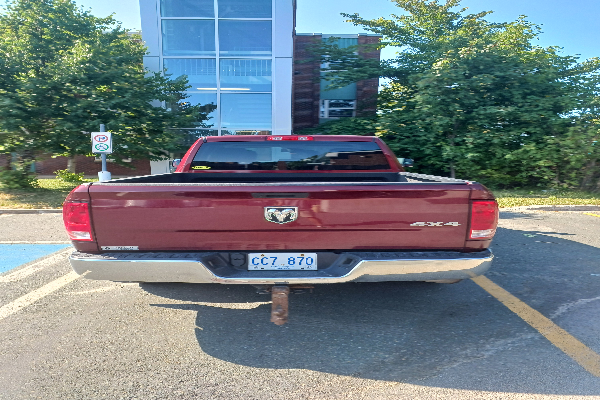

Brightened Image


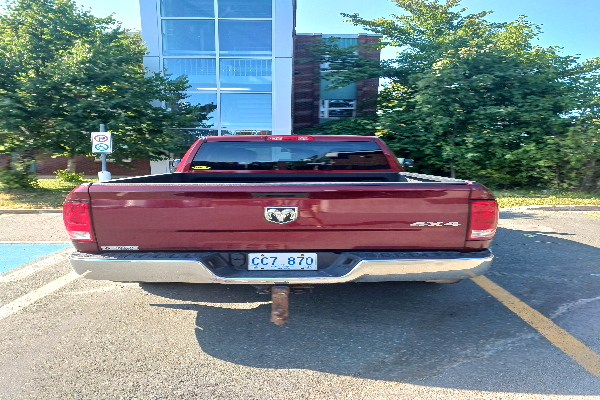

Grayscale Image


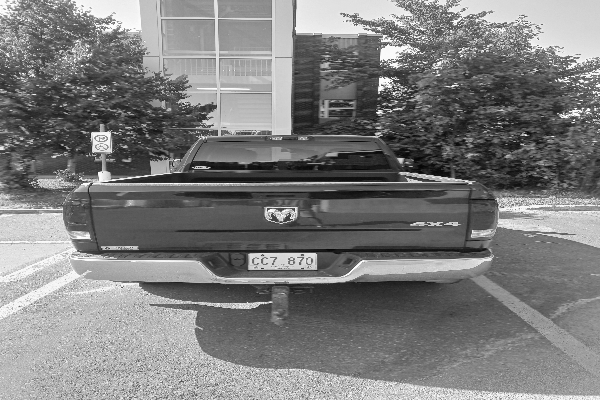

Blurred Image


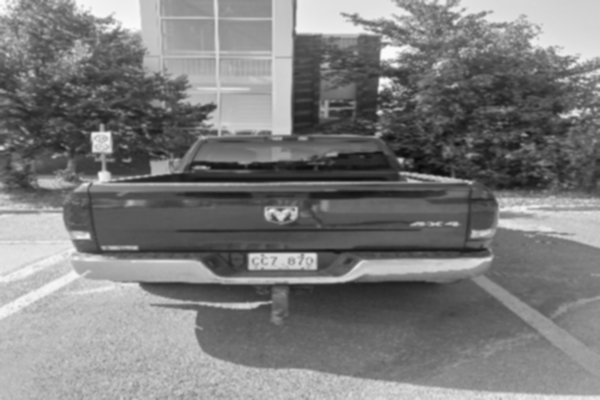

Adaptive threshold Image


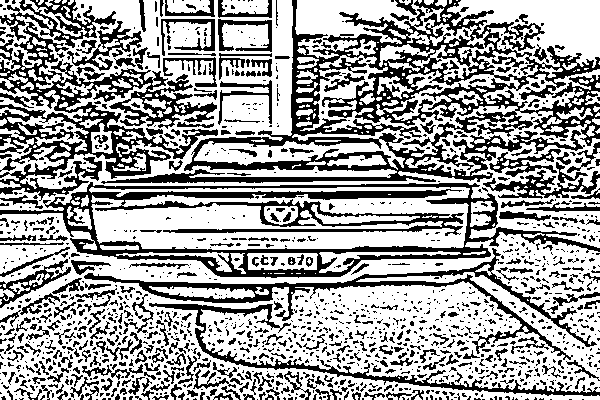

aspect:  4.176470588235294
area:  1063.5
approx:  [[[247 254]]

 [[248 269]]

 [[316 269]]

 [[316 253]]]
Final contour values - aspect: 4.176470588235294 area: 1063.5
aspect:  8.153846153846153
area:  710.0
approx:  [[[149 286]]

 [[184 296]]

 [[254 296]]

 [[243 288]]]
Approximations:  [array([[[247, 254]],

       [[248, 269]],

       [[316, 269]],

       [[316, 253]]], dtype=int32)]


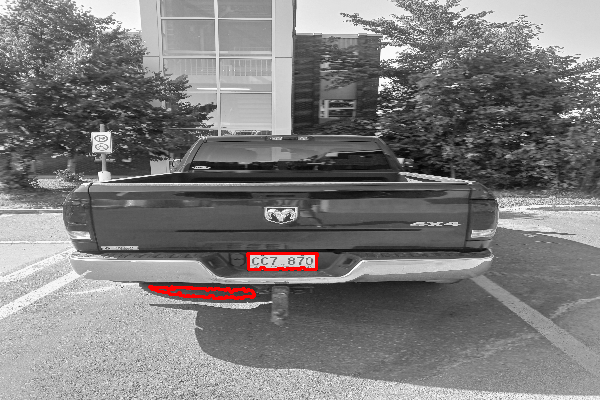

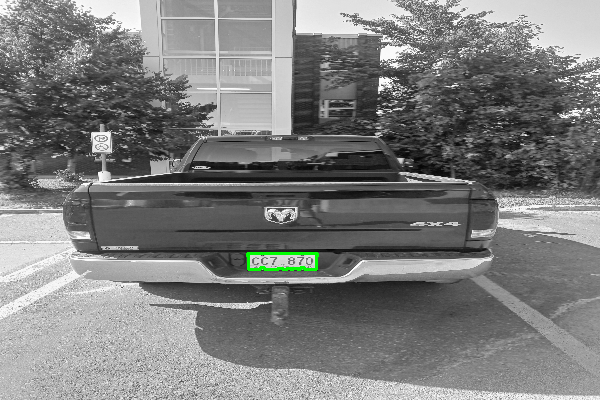

new_image after draw contours


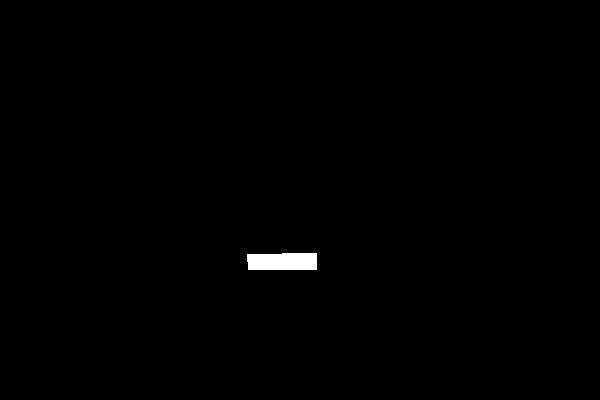

new_image after bitwise


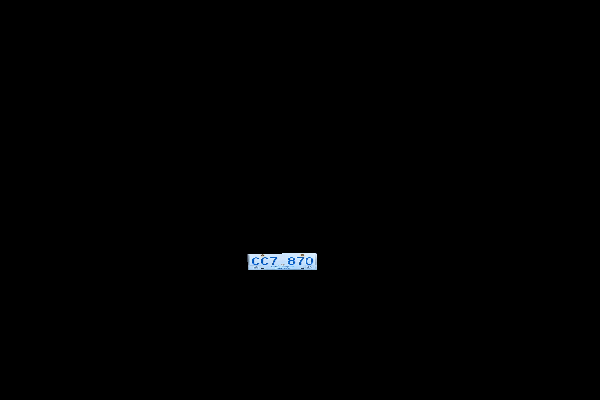

Detected Number Plate: c27_8i0
Detected Number Plate tes: C7  Bt



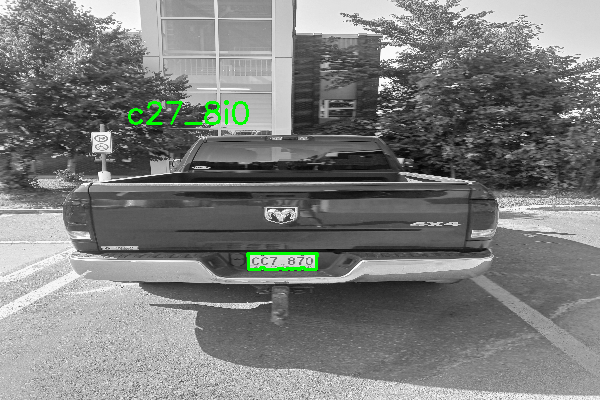

Original Image


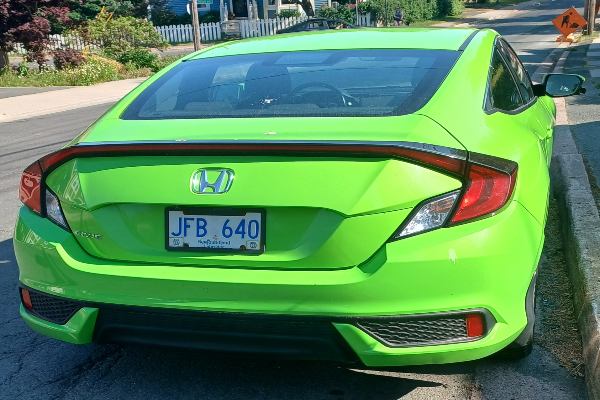

Brightened Image


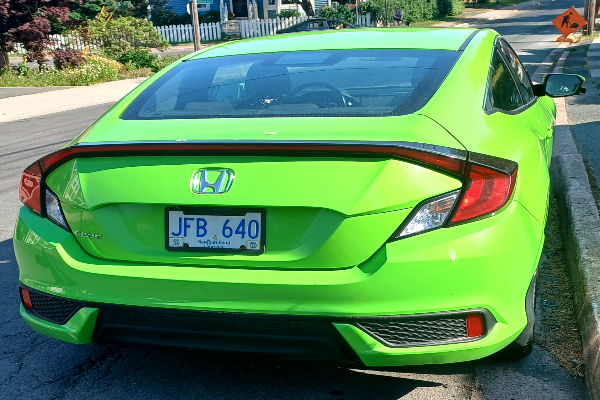

Grayscale Image


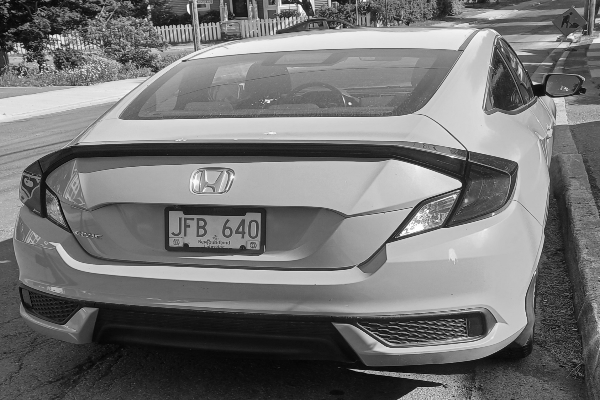

Blurred Image


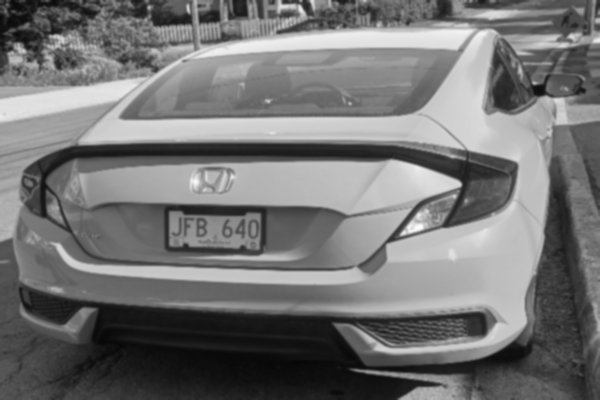

Adaptive threshold Image


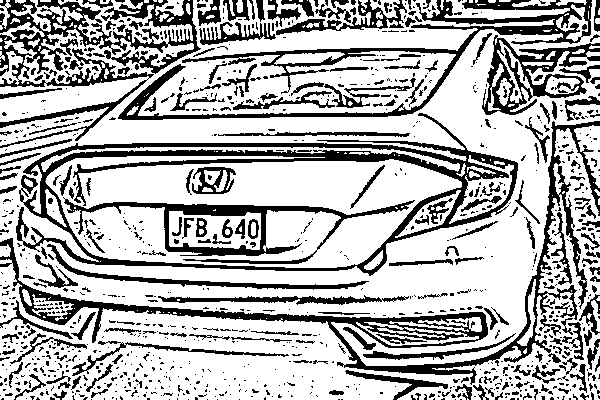

aspect:  3.7232142857142856
area:  34868.5
approx:  [[[ 45 181]]

 [[ 92 254]]

 [[285 267]]

 [[461 186]]]
aspect:  2.358974358974359
area:  2895.0
approx:  [[[169 211]]

 [[170 246]]

 [[259 249]]

 [[260 213]]]
Final contour values - aspect: 2.358974358974359 area: 2895.0
aspect:  6.75
area:  1769.0
approx:  [[[ 46 245]]

 [[ 98 273]]

 [[369 281]]

 [[120 281]]]
aspect:  1.375
area:  1004.0
approx:  [[[460 190]]

 [[424 205]]

 [[395 237]]

 [[441 224]]]
Final contour values - aspect: 1.375 area: 1004.0
aspect:  5.5
area:  780.5
approx:  [[[515 334]]

 [[441 360]]

 [[362 355]]

 [[464 349]]]
Approximations:  [array([[[169, 211]],

       [[170, 246]],

       [[259, 249]],

       [[260, 213]]], dtype=int32), array([[[460, 190]],

       [[424, 205]],

       [[395, 237]],

       [[441, 224]]], dtype=int32)]


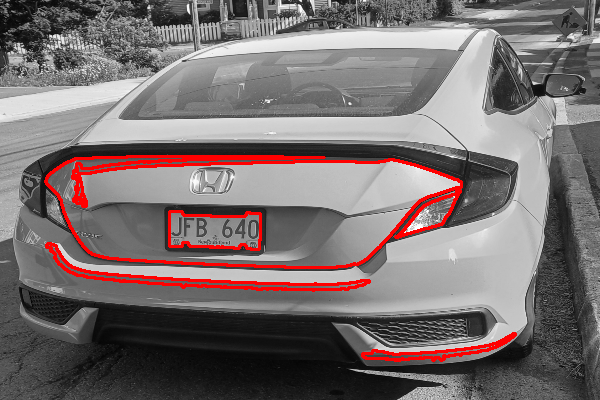

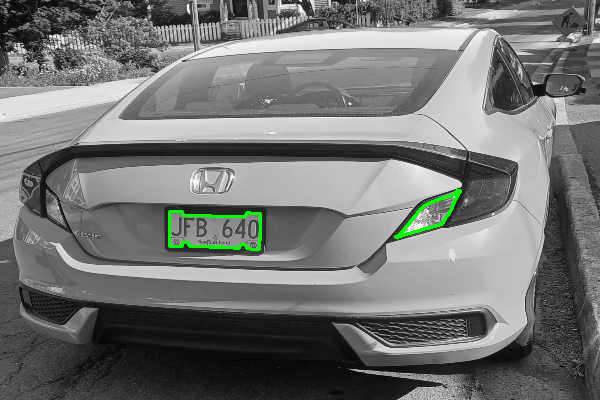

new_image after draw contours


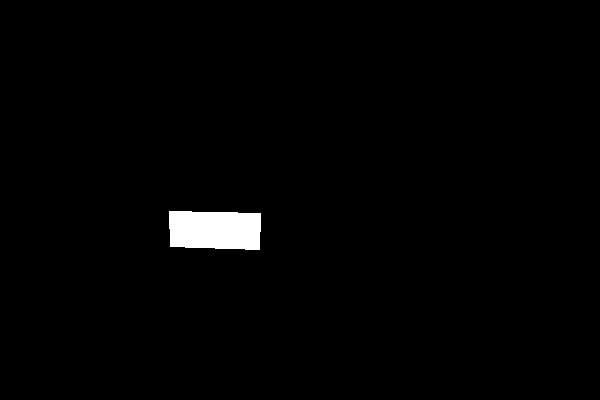

new_image after bitwise


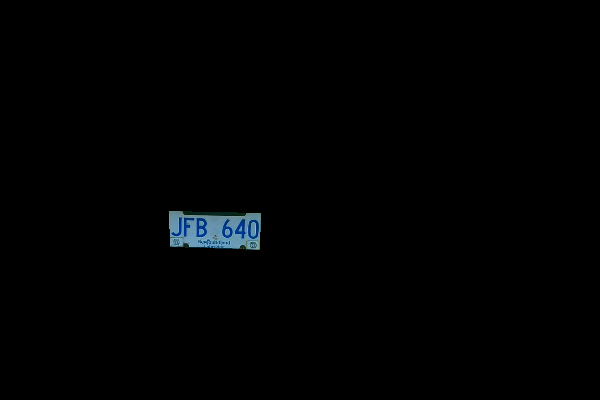

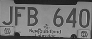

new_image after draw contours


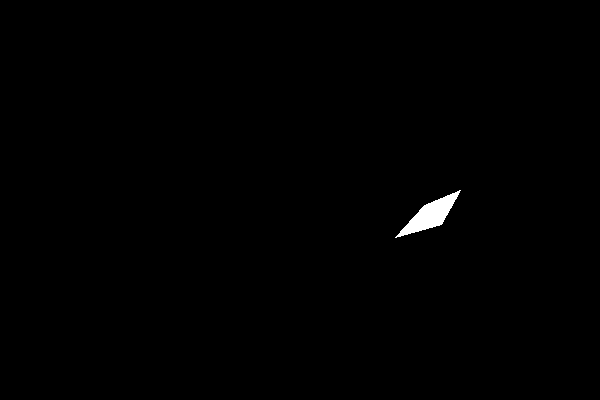

new_image after bitwise


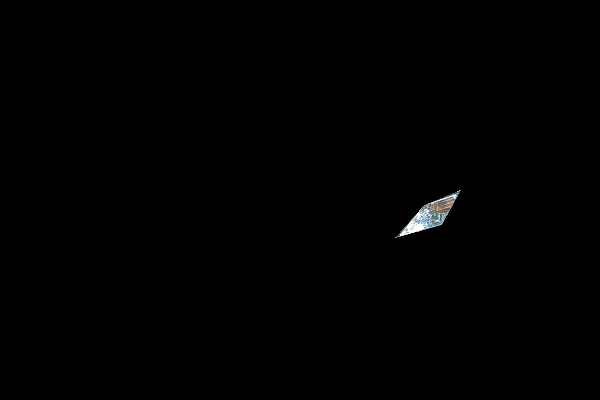

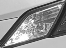

Detected Number Plate: JFB 640
Detected Number Plate tes: 40

d



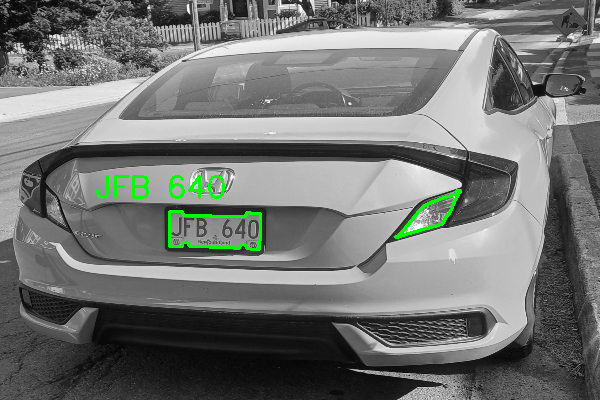

Original Image


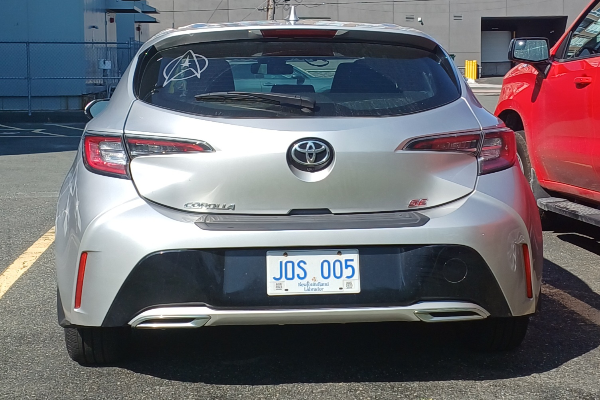

Brightened Image


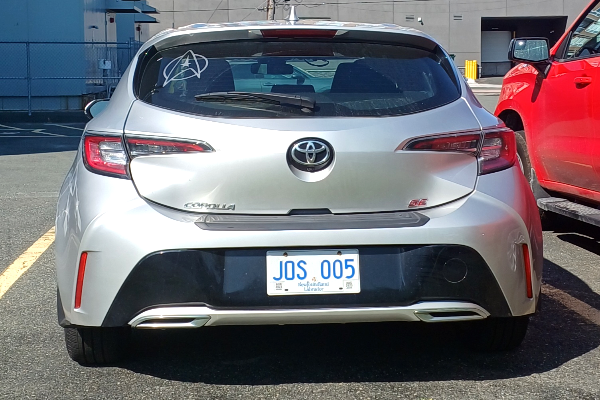

Grayscale Image


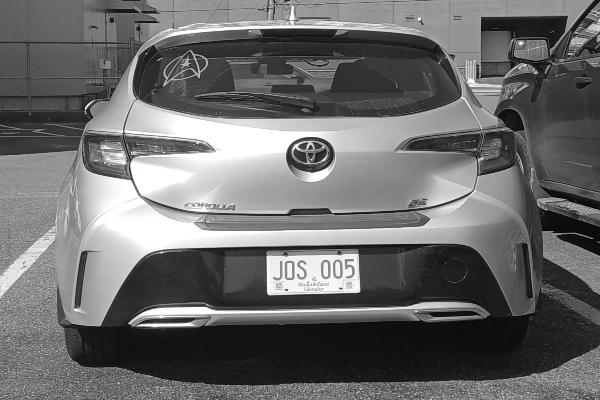

Blurred Image


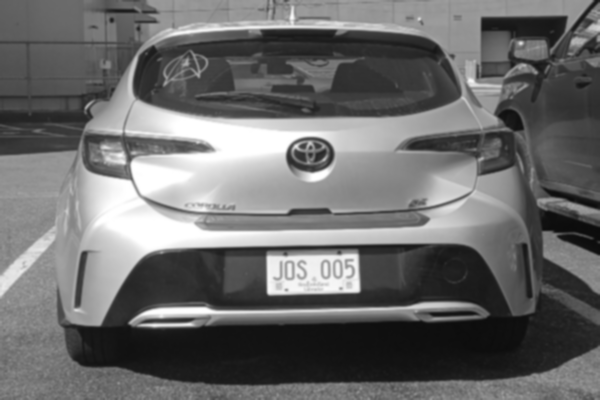

Adaptive threshold Image


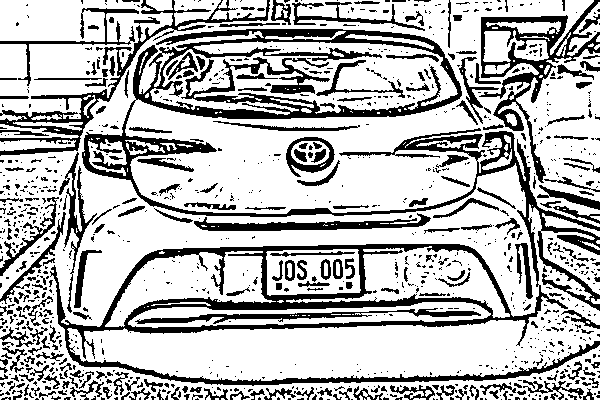

aspect:  2.021276595744681
area:  3954.0
approx:  [[[358 250]]

 [[267 251]]

 [[267 294]]

 [[359 292]]]
Final contour values - aspect: 2.021276595744681 area: 3954.0
Approximations:  [array([[[358, 250]],

       [[267, 251]],

       [[267, 294]],

       [[359, 292]]], dtype=int32)]


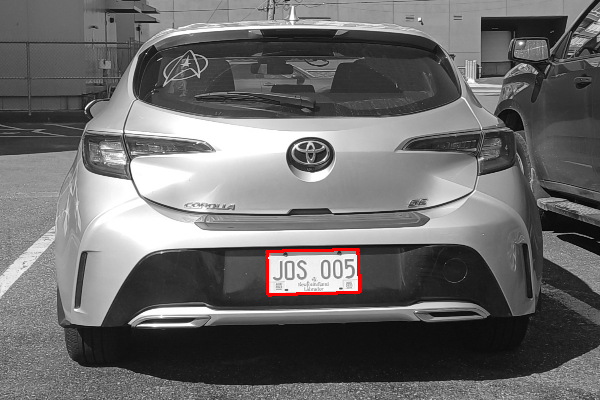

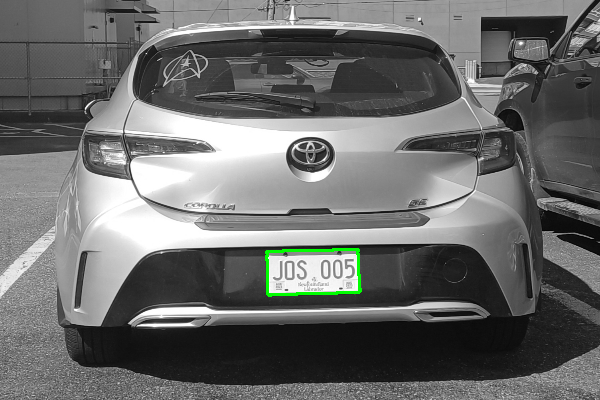

new_image after draw contours


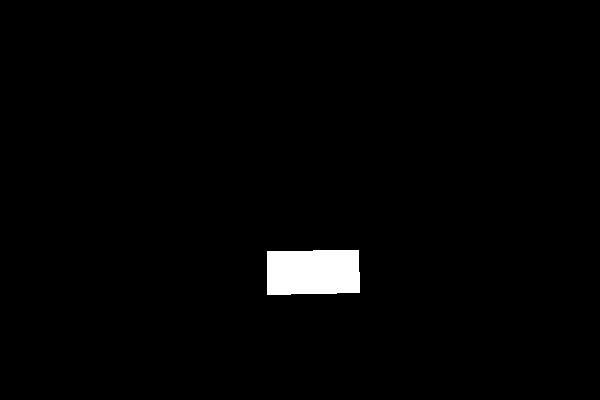

new_image after bitwise


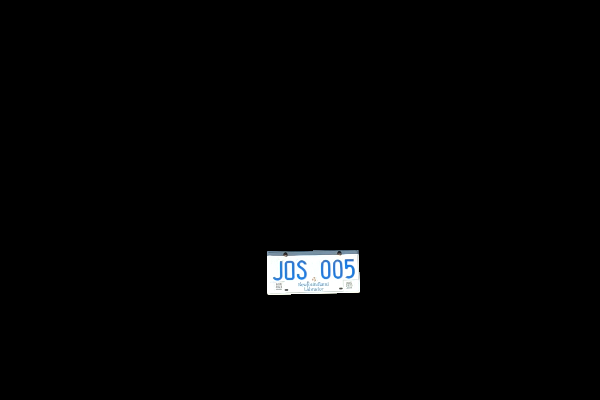

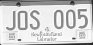

Detected Number Plate: JOS ,005
Detected Number Plate tes: 5 005



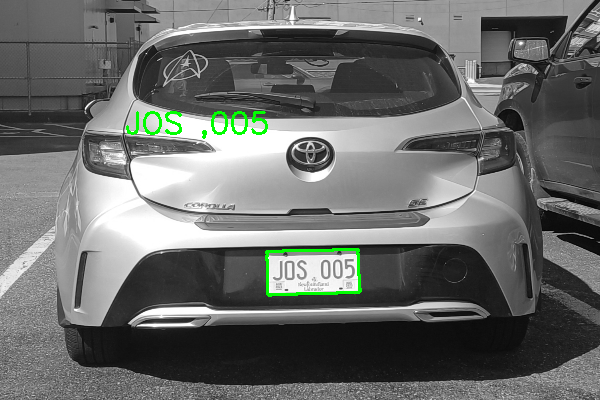

Original Image


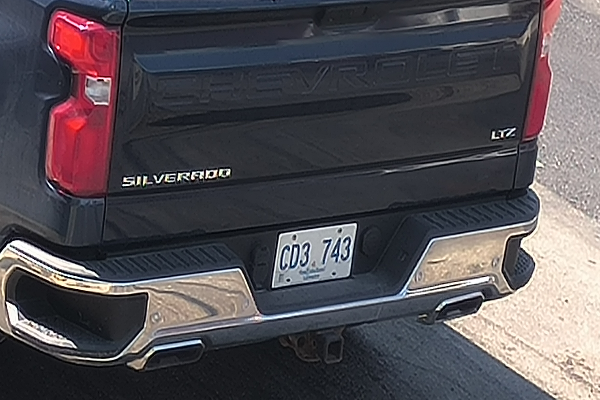

Brightened Image


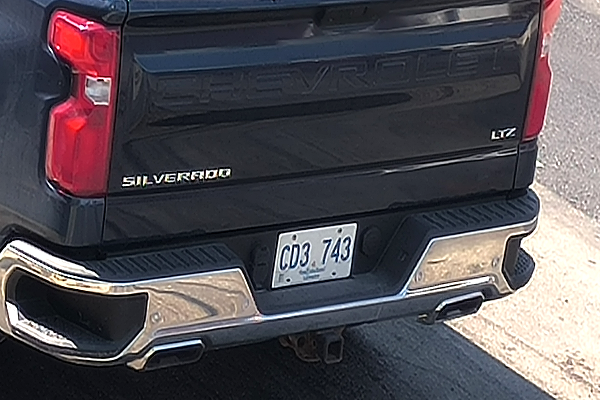

Grayscale Image


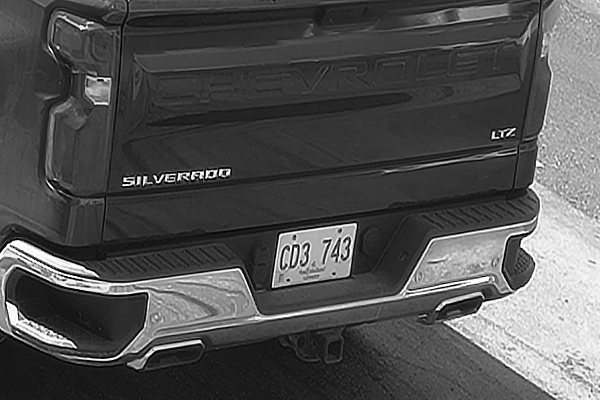

Blurred Image


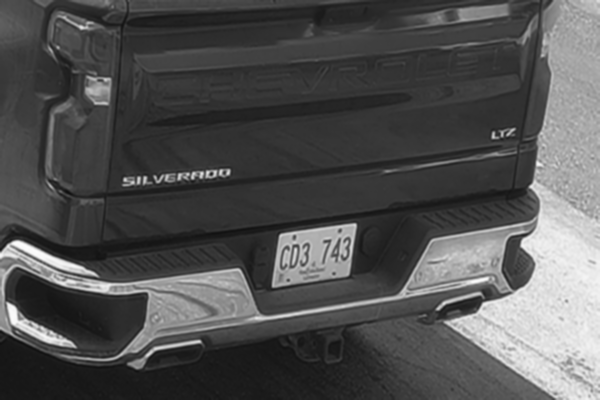

Adaptive threshold Image


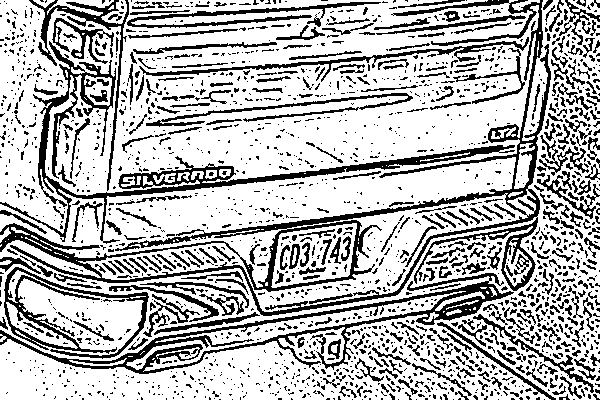

aspect:  1.323076923076923
area:  3996.5
approx:  [[[356 223]]

 [[281 233]]

 [[271 286]]

 [[347 276]]]
Final contour values - aspect: 1.323076923076923 area: 3996.5
Approximations:  [array([[[356, 223]],

       [[281, 233]],

       [[271, 286]],

       [[347, 276]]], dtype=int32)]


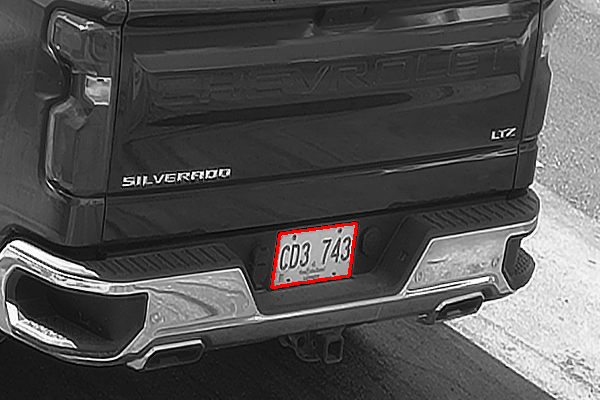

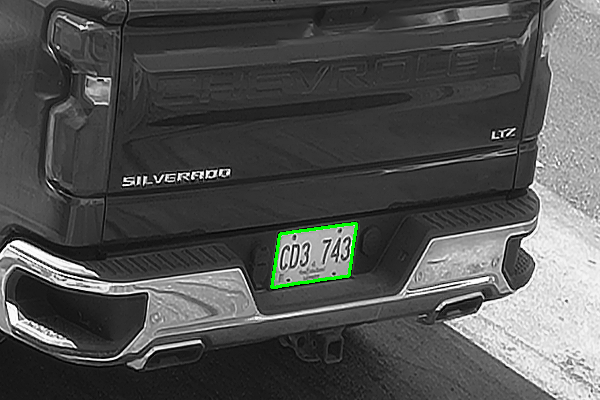

new_image after draw contours


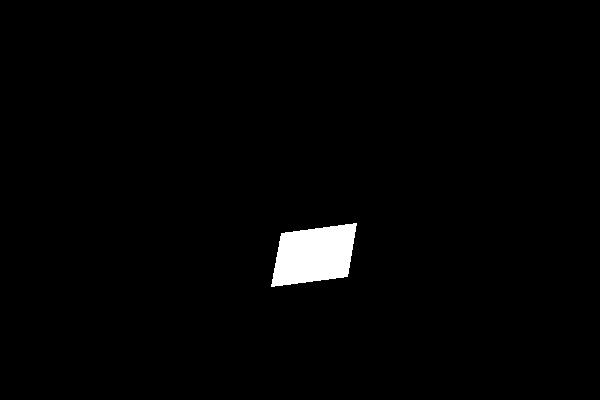

new_image after bitwise


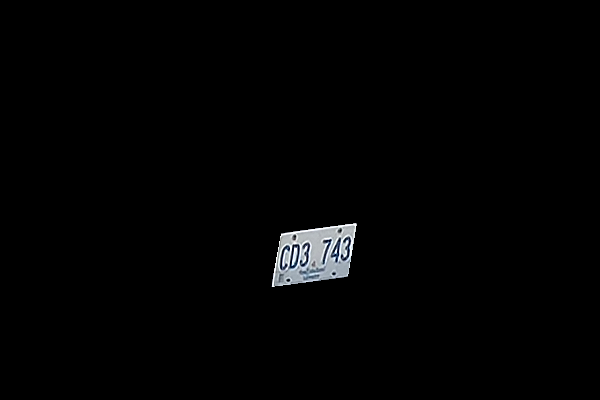

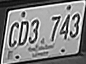

Detected Number Plate: Icos 743
Detected Number Plate tes: 


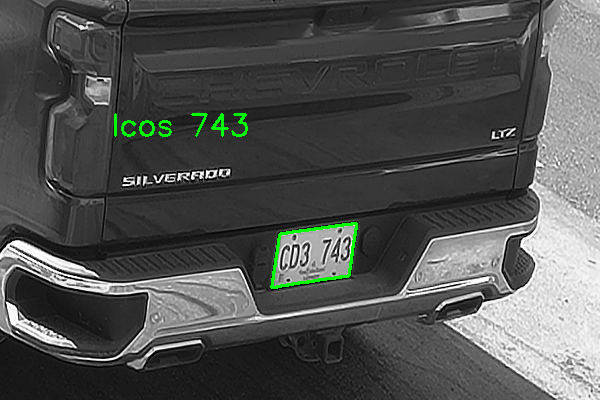

Original Image


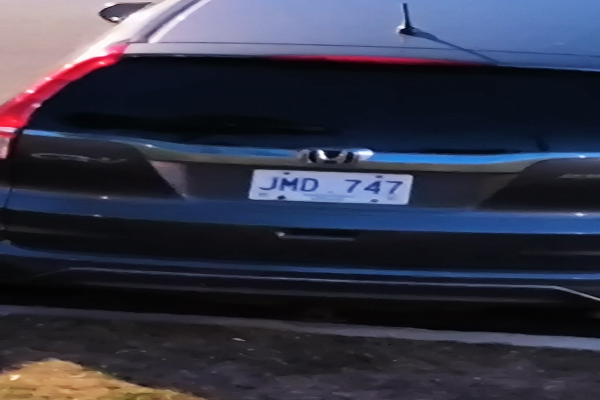

Brightened Image


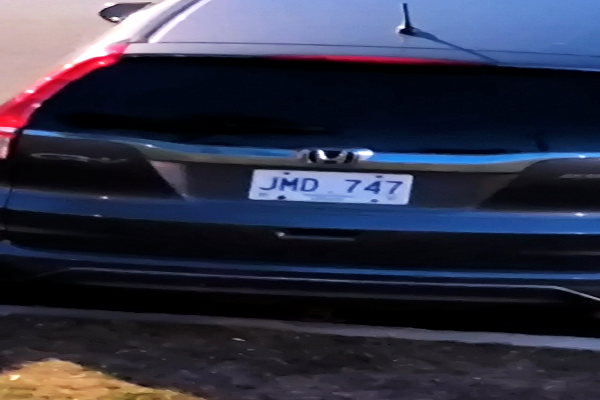

Grayscale Image


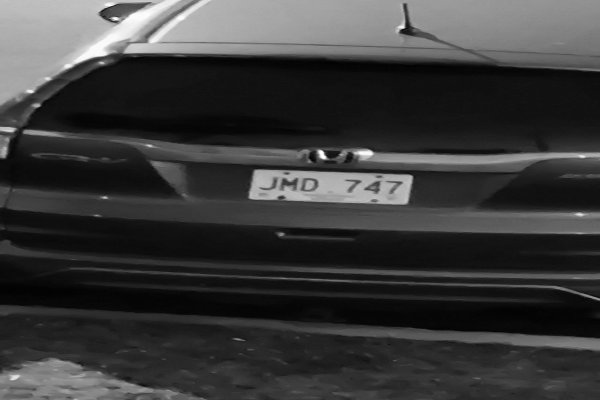

Blurred Image


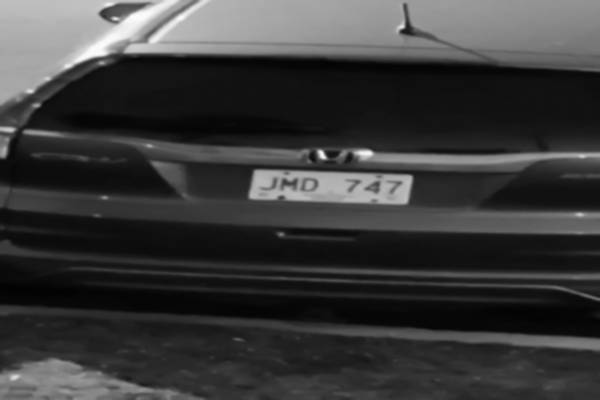

Adaptive threshold Image


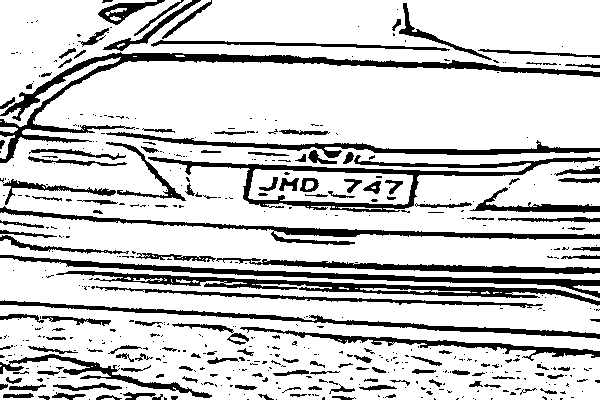

aspect:  3.4482758620689653
area:  75402.5
approx:  [[[  0 163]]

 [[595 234]]

 [[105 133]]

 [[599  77]]]
aspect:  4.583333333333333
area:  4619.5
approx:  [[[248 197]]

 [[404 204]]

 [[412 175]]

 [[255 169]]]
Final contour values - aspect: 4.583333333333333 area: 4619.5
aspect:  1.6101694915254237
area:  657.5
approx:  [[[402   3]]

 [[412  31]]

 [[492  59]]

 [[399  34]]]
aspect:  7.461538461538462
area:  400.0
approx:  [[[ 30 150]]

 [[ 71 148]]

 [[126 156]]

 [[112 160]]]
Approximations:  [array([[[248, 197]],

       [[404, 204]],

       [[412, 175]],

       [[255, 169]]], dtype=int32)]


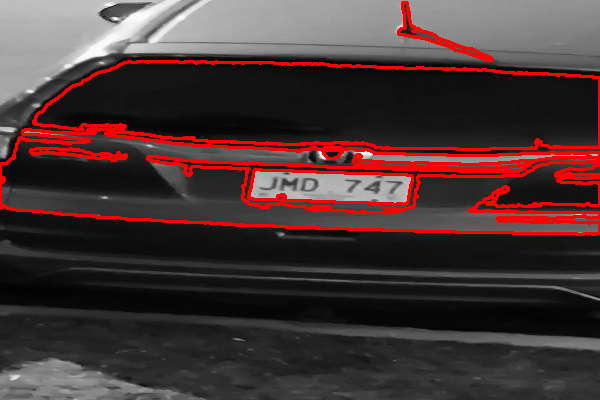

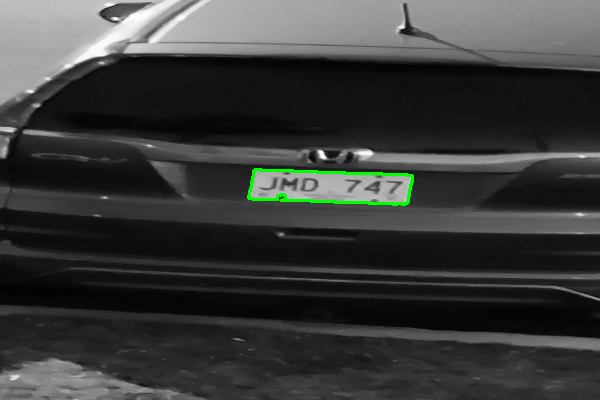

new_image after draw contours


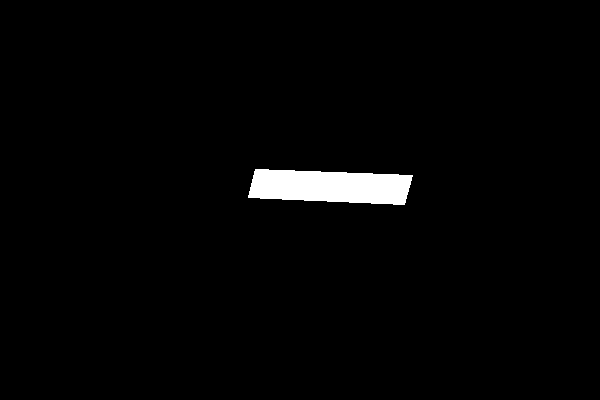

new_image after bitwise


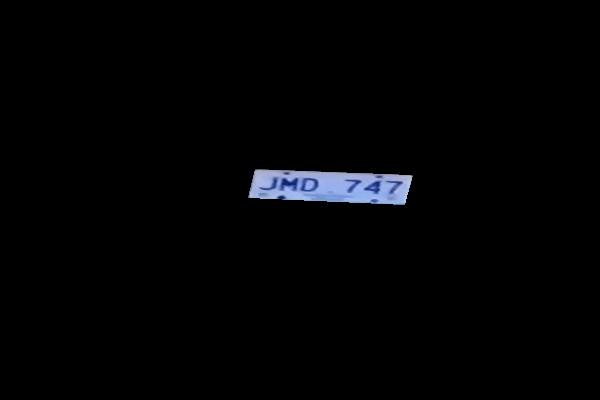

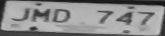

Detected Number Plate: JAD
Detected Number Plate tes: 


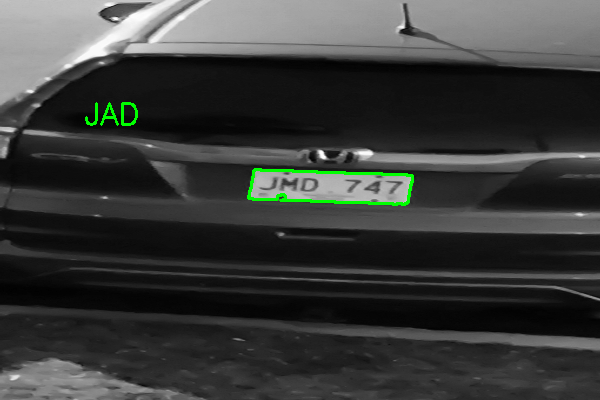

Original Image


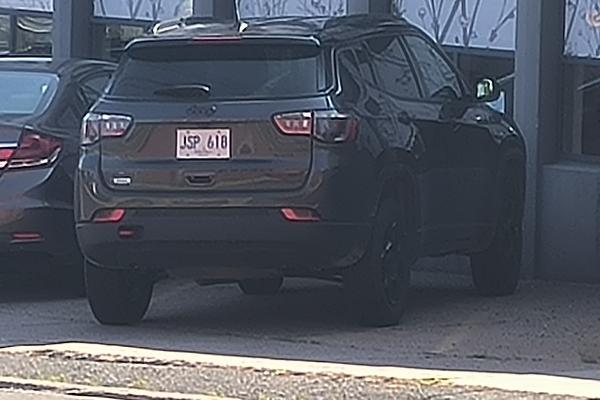

Brightened Image


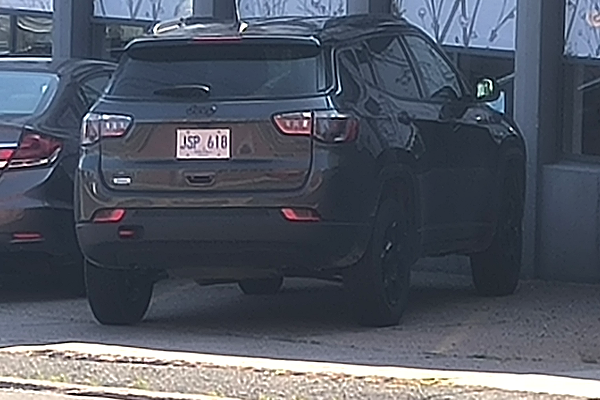

Grayscale Image


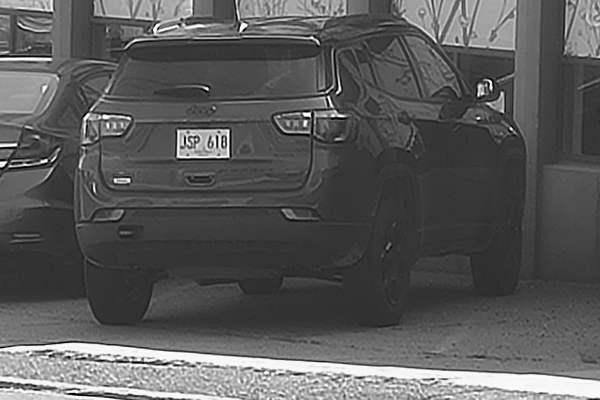

Blurred Image


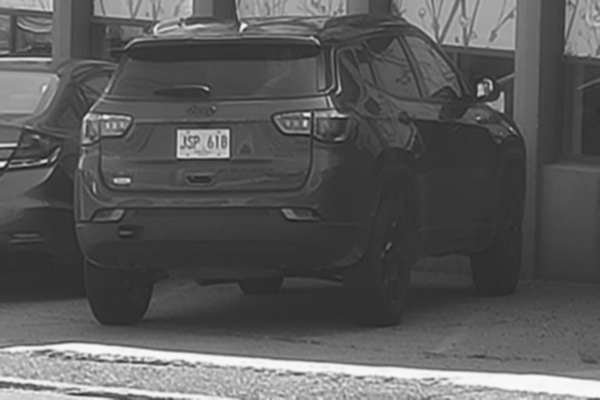

Adaptive threshold Image


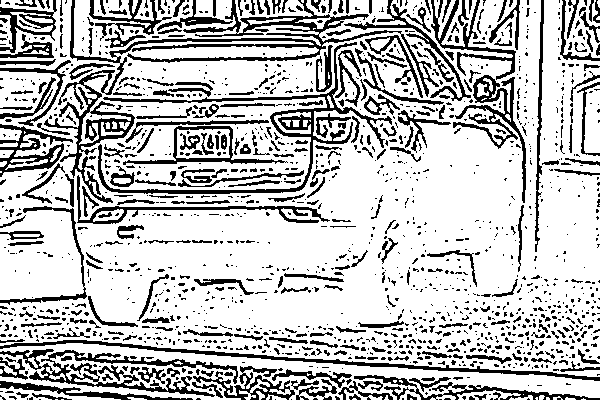

aspect:  5.0
area:  1895.5
approx:  [[[ 76 176]]

 [[ 79 219]]

 [[330 220]]

 [[ 77 223]]]
Final contour values - aspect: 5.0 area: 1895.5
aspect:  1.8
area:  1426.0
approx:  [[[177 129]]

 [[176 157]]

 [[229 157]]

 [[228 129]]]
Final contour values - aspect: 1.8 area: 1426.0
Approximations:  [array([[[ 76, 176]],

       [[ 79, 219]],

       [[330, 220]],

       [[ 77, 223]]], dtype=int32), array([[[177, 129]],

       [[176, 157]],

       [[229, 157]],

       [[228, 129]]], dtype=int32)]


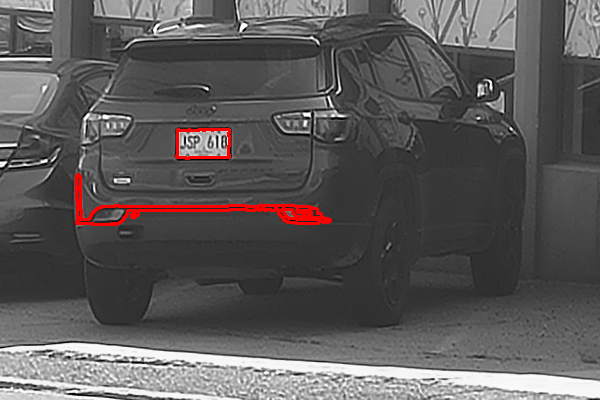

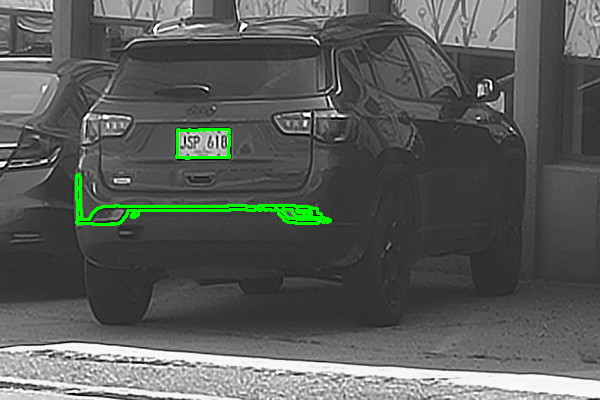

new_image after draw contours


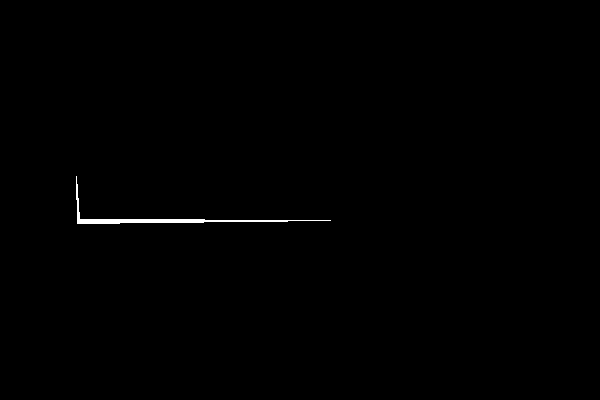

new_image after bitwise


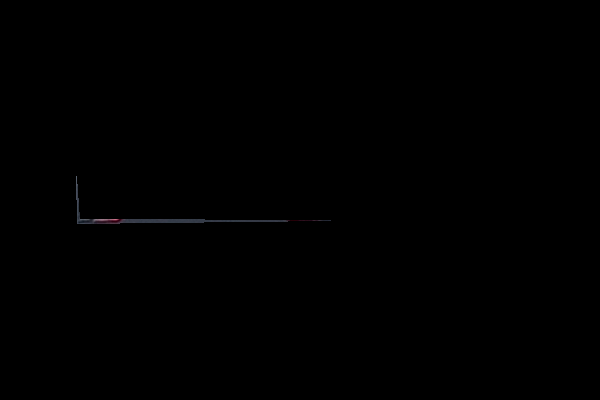

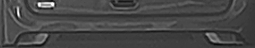

new_image after draw contours


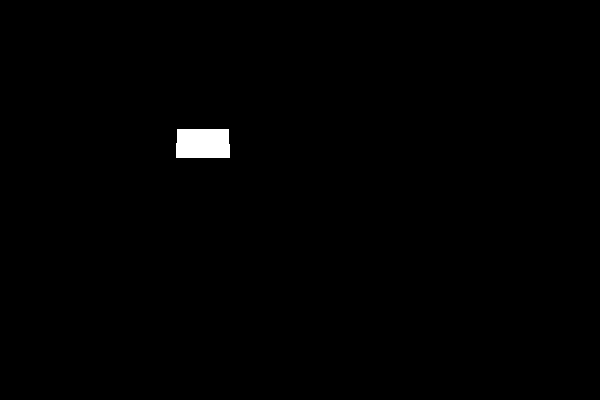

new_image after bitwise


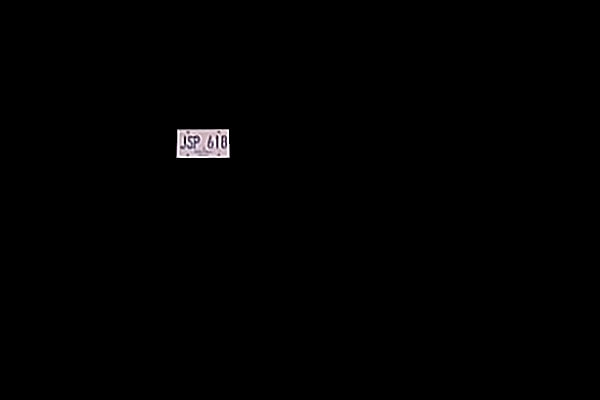

Detected Number Plate: V2 bi0
Detected Number Plate tes: eee eta
610



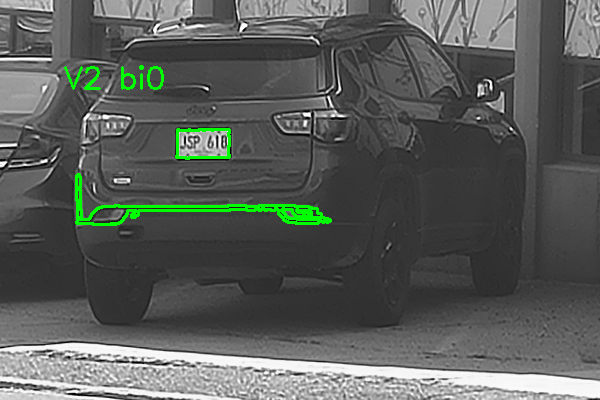

Original Image


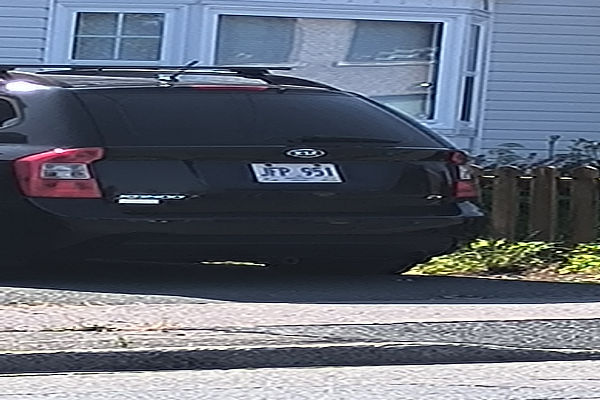

Brightened Image


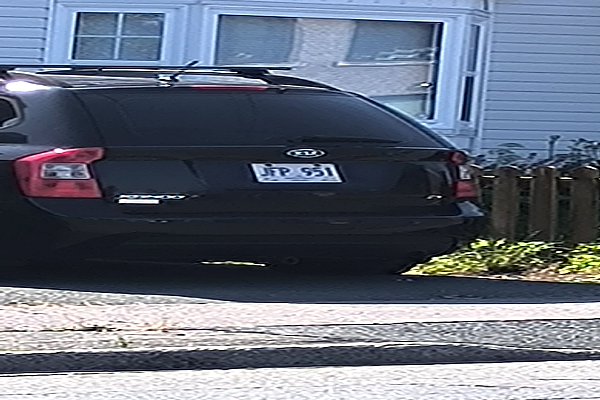

Grayscale Image


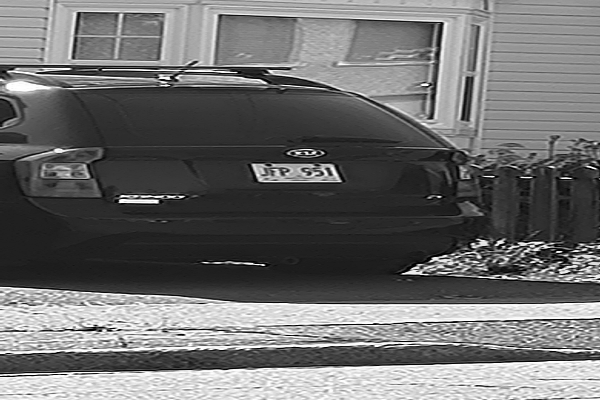

Blurred Image


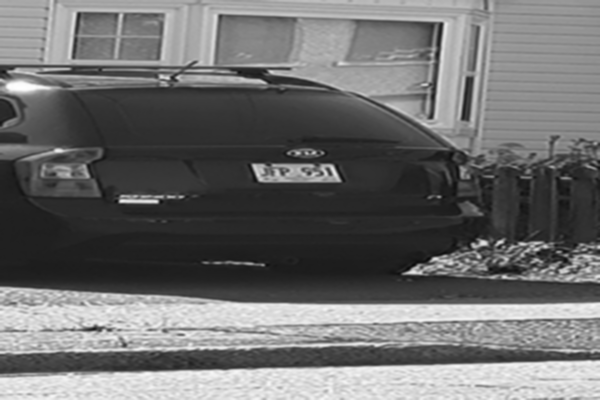

Adaptive threshold Image


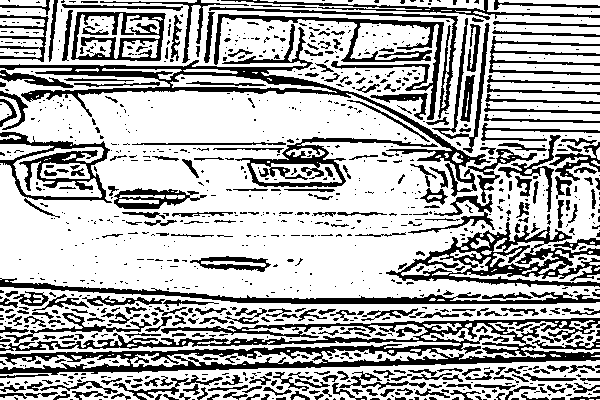

aspect:  1.9019607843137254
area:  4380.0
approx:  [[[ 76  12]]

 [[164  12]]

 [[161  59]]

 [[ 72  60]]]
Final contour values - aspect: 1.9019607843137254 area: 4380.0
aspect:  4.589743589743589
area:  2689.5
approx:  [[[599 321]]

 [[421 337]]

 [[592 353]]

 [[531 342]]]
Final contour values - aspect: 4.589743589743589 area: 2689.5
aspect:  2.2017543859649122
area:  1641.5
approx:  [[[208   8]]

 [[457  15]]

 [[450 105]]

 [[450  18]]]
Final contour values - aspect: 2.2017543859649122 area: 1641.5
aspect:  4.55
area:  1411.0
approx:  [[[251 163]]

 [[259 181]]

 [[341 182]]

 [[332 164]]]
Final contour values - aspect: 4.55 area: 1411.0
aspect:  8.666666666666666
area:  890.0
approx:  [[[  0 357]]

 [[  8 369]]

 [[129 365]]

 [[119 355]]]
Approximations:  [array([[[ 76,  12]],

       [[164,  12]],

       [[161,  59]],

       [[ 72,  60]]], dtype=int32), array([[[599, 321]],

       [[421, 337]],

       [[592, 353]],

       [[531, 342]]], dtype=int32), array([[[208,   8]],

 

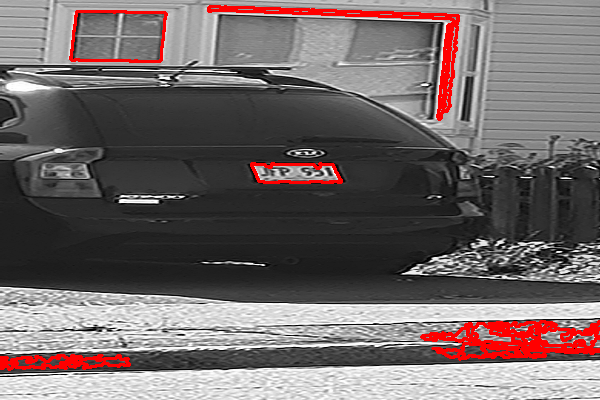

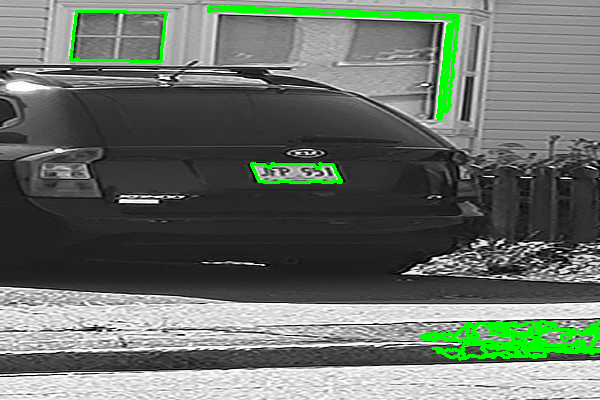

new_image after draw contours


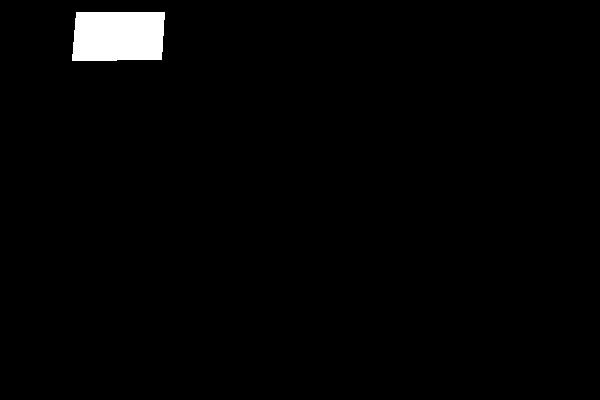

new_image after bitwise


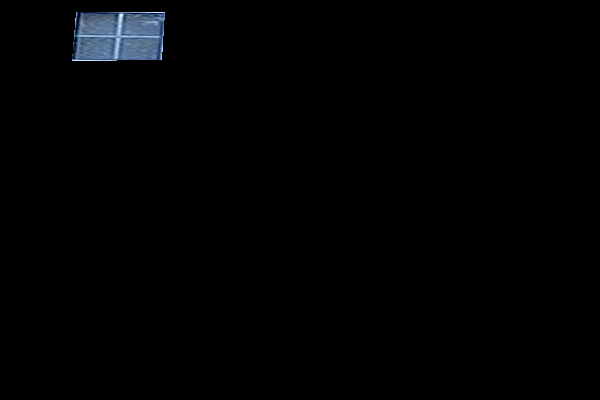

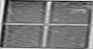

new_image after draw contours


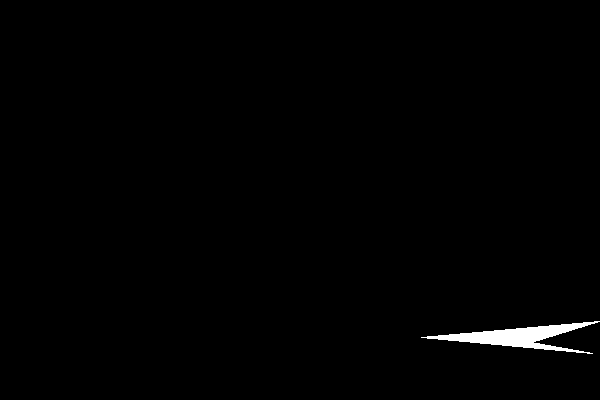

new_image after bitwise


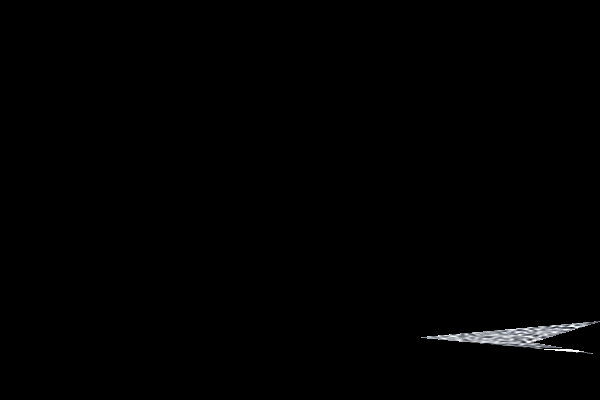

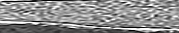

new_image after draw contours


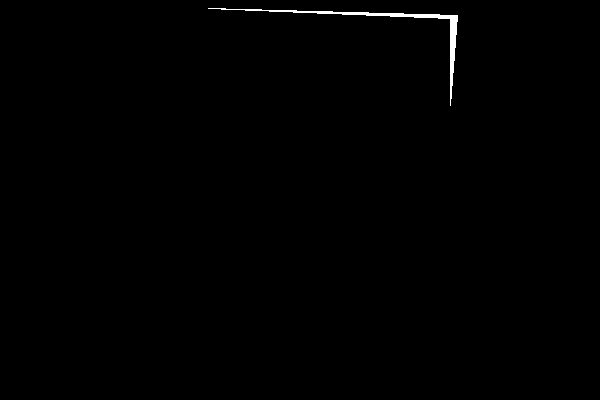

new_image after bitwise


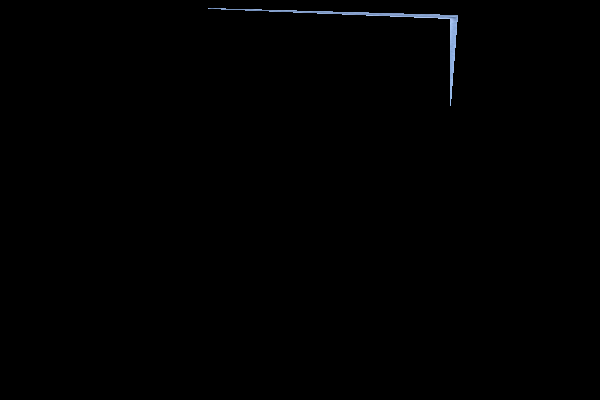

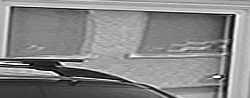

new_image after draw contours


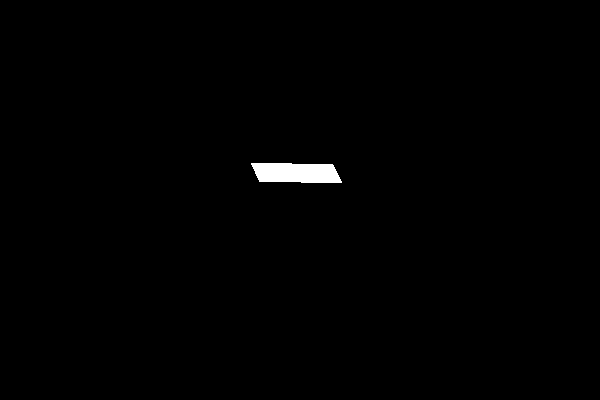

new_image after bitwise


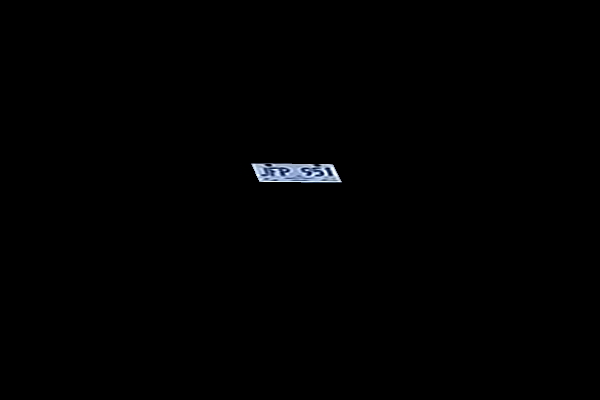

Detected Number Plate: 4r 5
Detected Number Plate tes: jf 
eee
————a

=



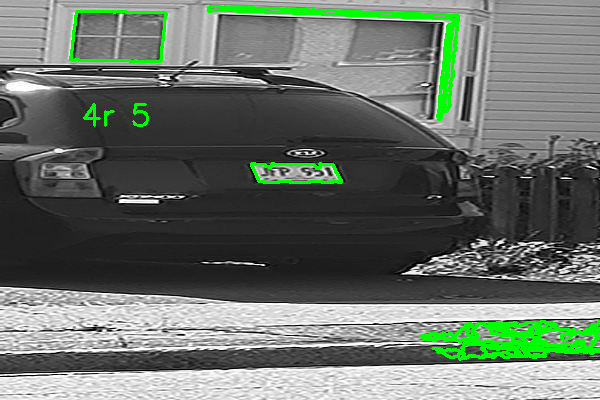

In [7]:
def read_car_plate(image_path):
    # Step 1: Read image
    img = cv2.imread(image_path)
    resized_img = cv2.resize(img, (600, 400))
    print("Original Image")
    cv2_imshow(resized_img)
    resized_img = adjust_brightness_contrast(resized_img, brightness=10, contrast=10)
    print("Brightened Image")
    cv2_imshow(resized_img)

    # Step 2: Convert image to grayscale and apply blur
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    resized_gray = cv2.resize(gray, (600, 400))
    print("Grayscale Image")
    cv2_imshow(resized_gray)
    blur = cv2.GaussianBlur(resized_gray, (5,5), 0)
    print("Blurred Image")
    cv2_imshow(blur)
    # _, thresh = cv2.threshold(blur, 127, 255, cv2.THRESH_BINARY)
    thresh = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    print("Adaptive threshold Image")
    cv2_imshow(thresh)

    # resized_gray = cv2.bilateralFilter(resized_gray, 13, 15, 15)
    # edged = cv2.Canny(resized_gray, 30, 200) #Perform Edge detection
    # contours=cv2.findContours(edged.copy(),cv2.RETR_TREE,
    #                                             cv2.CHAIN_APPROX_SIMPLE)
    # contours = imutils.grab_contours(contours)
    # contours = sorted(contours,key=cv2.contourArea, reverse = True)[:10]
    # screenCnt = None

    # Step 3: Apply edge detection
    # thresh = cv2.Canny(blur, 50, 150)
    # thresh = cv2.dilate(thresh, None, iterations=1)
    # thresh = cv2.erode(thresh, None, iterations=1)

    # _, thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    # kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    # morph_opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    # contours, _ = cv2.findContours(morph_opening, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Step 4: Find contours and filter for the largest one
    contours, _ = cv2.findContours(thresh.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)[:20]

    min_area = 1000
    max_area = 11600
    min_aspect = 1.25
    max_aspect = 4.6

    all_contours = []
    number_plate_contours = []
    number_plate_approximations = []
    for contour in contours:
        approx = cv2.approxPolyDP(contour, 0.02 * cv2.arcLength(contour, True), True)
        area = cv2.contourArea(contour)
        if len(approx) == 4:
            all_contours.append(contour)
            x, y, w, h = cv2.boundingRect(contour)
            aspect = float(w) / h
            print("aspect: ", aspect)
            print("area: ", area)
            print("approx: ", approx)
            if aspect > min_aspect and aspect < max_aspect + 0.5 and area > min_area and area < max_area:
                print(f"Final contour values - aspect: {aspect} area: {area}")
                number_plate_contours.append(contour)
                number_plate_approximations.append(approx)

    print("Approximations: ", number_plate_approximations)

    # Draw contours on the original image
    img1 = cv2.cvtColor(resized_gray, cv2.COLOR_GRAY2RGB)
    cv2.drawContours(img1, number_plate_contours, -1, (0, 255, 0), 2)
    img2 = cv2.cvtColor(resized_gray, cv2.COLOR_GRAY2RGB)
    cv2.drawContours(img2, all_contours, -1, (0, 0, 255), 2)

    cv2_imshow(img2)
    cv2_imshow(img1)
    number_plate_text = ""
    number_plate_text_tes = ""

    for number_plate_approximation in number_plate_approximations:
        mask = np.zeros(resized_gray.shape, np.uint8) #create blank image with same dimensions as the original image
        new_image = cv2.drawContours(mask, [number_plate_approximation], 0,255, -1) #Draw contours on the mask image
        print("new_image after draw contours")
        cv2_imshow(new_image)
        new_image = cv2.bitwise_and(resized_img, resized_img, mask=mask) #Take bitwise AND between the original image and mask image
        print("new_image after bitwise")
        cv2_imshow(new_image)

        (x,y) = np.where(mask==255) #Find the co-ordinates of the four corners of the document
        (x1, y1) = (np.min(x), np.min(y)) #Find the top left corner
        (x2, y2) = (np.max(x), np.max(y)) #Find the bottom right corner
        cropped_image = resized_gray[x1:x2+1, y1:y2+1] #Crop the image using the co-ordinates

        cv2_imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)) #show the cropped image

        reader = easyocr.Reader(['en']) #create an easyocr reader object with english as the language
        result = reader.readtext(cropped_image) #read text from the cropped image
        text = pytesseract.image_to_string(cropped_image, config='--psm 11')
        if len(result) > 0 and len(result[0]) > 1:
            number_plate_text += result[0][1]
        if len(text) > 0:
            number_plate_text_tes += text
    number_plate_text = number_plate_text.replace('.', ' ')
    number_plate_text_tes = number_plate_text_tes.replace('.', ' ')
    print("Detected Number Plate:", number_plate_text)
    print("Detected Number Plate tes:", number_plate_text_tes)

    position = (int(x1/2), int(y1/2))  # (x, y) coordinates of the text's start position
    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 1
    color = (0, 255, 0)  # Color of the text in BGR format (black in this case)
    thickness = 2

    # Put the text on the image
    cv2.putText(img1, number_plate_text, position, font, font_scale, color, thickness)

    # Display the image with the text
    cv2_imshow(img1)

images_to_ignore = []

for i in range(1, 11):
    if i in images_to_ignore:
        continue
    image_path = f'/content/drive/MyDrive/content/{i}.jpg'
    read_car_plate(image_path)